In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils import data
import torchvision
from torchvision import transforms

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob 
from PIL import Image

In [4]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim
from skimage.measure import shannon_entropy

In [5]:
torch.__version__

'1.13.1+cu117'

In [6]:
#获取测试数据路径
# train_irimgs_path = glob.glob('data/MSRS-main/train/ir/*.png')
# train_viimgs_path = glob.glob('data/MSRS-main/train/vi/*.png')
# train_irimgs_path = glob.glob('data/TNO/ir/*.png')
# train_viimgs_path = glob.glob('data/TNO/vi/*.png')
train_irimgs_path = glob.glob('data/output/output_ir/*.png')
train_viimgs_path = glob.glob('data/output/output_vi/*.png')
# 获取测试数据路径
test_irimgs_path = glob.glob('data/MSRS-main/test/ir/*.png')
test_viimgs_path = glob.glob('data/MSRS-main/test/vi/*.png')

In [34]:
transform = transforms.Compose([
                             # transforms.Resize(28),
                             transforms.CenterCrop(128),
                             transforms.ToTensor(),
                             transforms.Normalize(
                                 # mean=[0.485, 0.456, 0.406], 
                                 # std=[0.229, 0.224, 0.225]
                                mean=0.5, 
                                 std=0.5
                             )
                            ])

In [35]:
vi_img = Image.open(train_viimgs_path[1])
ir_img = Image.open(train_irimgs_path[1])
ir_img = ir_img.convert('RGB')

In [36]:
np.array(ir_img).shape,np.array(vi_img).shape

((576, 768, 3), (576, 768, 3))

In [37]:
class FusionDataset(data.Dataset):
    def __init__(self,ir_path,vi_path):
        self.ir_path = train_irimgs_path
        self.vi_path = train_viimgs_path
    def __getitem__(self,idx):
        # 得到路径
        vi_path = self.vi_path[idx]
        ir_path = self.ir_path[idx]
        # 根据路径得到图片
        vi_img = Image.open(vi_path)
        ir_img = Image.open(ir_path) #ir红外读取为灰度秃了
        vi_img = transform(vi_img)
        ir_img = ir_img.convert('RGB')# 将灰度图转换为三通道再变化
        ir_img = transform(ir_img)
        return vi_img,ir_img
    def __len__(self):
        return len(self.ir_path)
        

In [38]:

train_ds = FusionDataset(train_irimgs_path,train_viimgs_path)
test_ds = FusionDataset(test_irimgs_path,test_viimgs_path)

In [39]:
BATCHSIZE = 128
train_dl = data.DataLoader(dataset=train_ds,
                          batch_size=BATCHSIZE,
                          shuffle=True)

test_dl = data.DataLoader(dataset=test_ds,
                          batch_size=BATCHSIZE,
                          shuffle=False)

In [40]:
ir_batch,vi_batch = next(iter(train_dl))

In [41]:
ir_batch.shape,vi_batch.shape

(torch.Size([128, 3, 128, 128]), torch.Size([128, 3, 128, 128]))

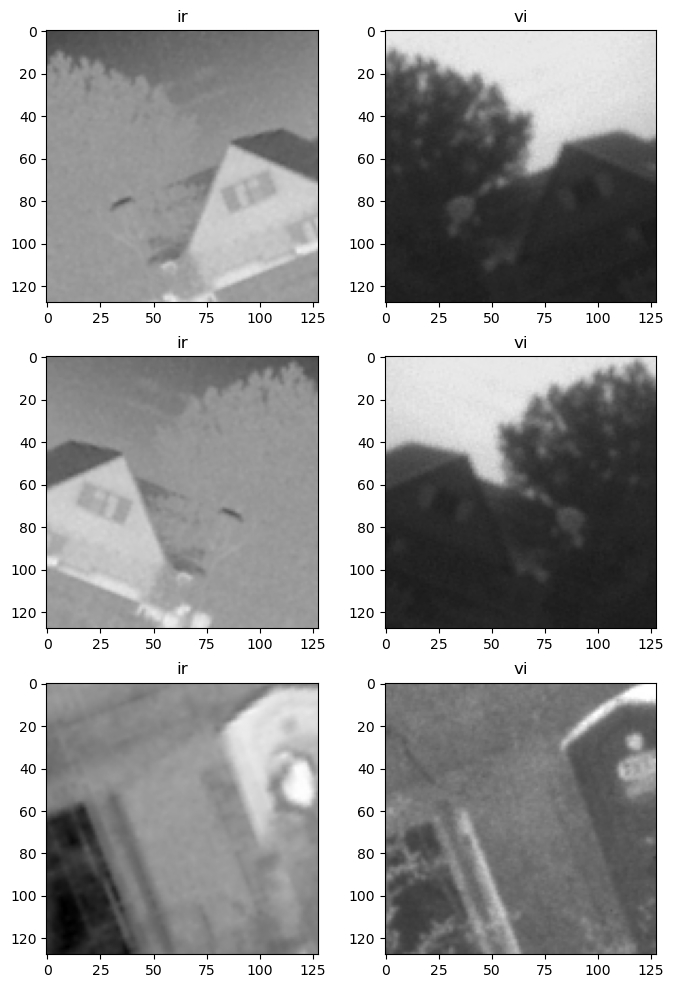

In [42]:
plt.figure(figsize = (8,12))
for i,(vi,ir) in enumerate(zip(ir_batch[:3],vi_batch[:3])):
    ir = (ir.permute(1,2,0).numpy()+1)/2
    vi = (vi.permute(1,2,0).numpy()+1)/2
    # ir = (ir.permute(1,2,0).numpy())
    # vi = (vi.permute(1,2,0).numpy())
    plt.subplot(3,2,2*i+1)
    plt.title('ir')
    plt.imshow(ir)
    plt.subplot(3,2,2*i+2)
    plt.title('vi')
    plt.imshow(vi)

In [43]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        # Define the encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(6, 64, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(64, 128, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(128, 256, 3, stride=2, padding=1),
            nn.ReLU(True),
            nn.Conv2d(256, 512, 3, stride=2, padding=1),
            nn.ReLU(True)
        )
        # Define the decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 3, 4, stride=2, padding=1),
            nn.Tanh()
        )
    def forward(self, x):
        # print(f'初始图像：{x.shape}')
        x = self.encoder(x)
        # print(f'编码器图像：{x.shape}')
        x = self.decoder(x)
        # print(f'解码器图像：{x.shape}')
        return x

In [44]:
#定义下采样模块
class Downsample(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(Downsample,self).__init__()
        self.conv_relu = nn.Sequential(
            nn.Conv2d(in_channels,out_channels,
                     kernel_size=3,
                     stride = 2,
                     padding=1),
            nn.LeakyReLU(inplace=True)
        )
        self.bn = nn.BatchNorm2d(out_channels)
    def forward(self,x,is_bn=True):
    # 生成器的输出层和判别器的输入层不使用BN
        x = self.conv_relu(x)
        if is_bn:
            x = self.bn(x)
        return x


In [45]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator,self).__init__()
        self.main = Autoencoder()
    def forward(self,x1,x2):
        x = torch.cat([x1,x2],axis = 1)
        # x = x1*0.5 + x2*0.5
        x = self.main(x)
        return x

In [46]:
class Discriminator(nn.Module):
    # ir + vi concat
    def __init__(self):
        super(Discriminator,self).__init__()
        self.down1 = Downsample(3,64)
        self.down2 = Downsample(64,128)
        self.conv1 = nn.Conv2d(128,256,3)
        self.bn = nn.BatchNorm2d(256)
        self.last = nn.Conv2d(256,1,3)
    def forward(self,ir,vi):
        # x = torch.cat([ir,vi],axis = 1)
        # x = ir*0.5 + vi*0.5
        x = vi
        x = self.down1(x,is_bn=False)
        x = self.down2(x,is_bn=False)
        x = F.dropout2d(self.bn(F.leaky_relu(self.conv1(x))))
        x = torch .sigmoid(self.last(x))
        return x

In [47]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [48]:
gen = Generator().to(device)
dis = Discriminator().to(device)
if torch.cuda.device_count() > 1:
    gen = nn.DataParallel(gen)  # 就在这里wrap一下，模型就会使用所有的GPU
    dis = nn.DataParallel(dis)  # 就在这里wrap一下，模型就会使用所有的GPU

In [49]:
d_optimizer = torch.optim.Adam(dis.parameters(),lr = 1e-4,betas=(0.5,0.999))
g_optimizer = torch.optim.Adam(gen.parameters(),lr = 1e-4,betas=(0.5,0.999))

In [50]:
# 定义损失函数
# loss_fn = torch.nn.BCELoss()
loss_fn = torch.nn.MSELoss()

# L1

In [51]:
LAMDA = 9

In [52]:
def calculate_metrics(vi, ir,fusion):
    # Information Entropy (EN)
    def calculate_entropy(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        entropy_value = shannon_entropy(img_gray)
        return entropy_value

    # Standard Deviation (SD)
    def calculate_sd(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        sd_value = np.std(img_gray)
        return sd_value

    # Structural Similarity Index (SSIM)
    def calculate_ssim(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        ssim_index_A, _ = ssim(img1_gray, fusion_gray, full=True)
        ssim_index_B, _ = ssim(img2_gray, fusion_gray, full=True)
        return (ssim_index_A + ssim_index_B)/2 

    

    # Correlation Coefficient (CC)
    def calculate_cc(vi, ir ,fusion):
        img1_flat = vi.flatten()
        img2_flat = ir.flatten()
        fusion_flat = fusion.flatten()
        
        correlation_coefficient_A = np.corrcoef(img1_flat, fusion_flat)[0, 1]
        correlation_coefficient_B = np.corrcoef(img2_flat, fusion_flat)[0, 1]
        
        return (correlation_coefficient_A + correlation_coefficient_B)/2

    # Spatial Frequency (SF)
    def calculate_sf(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        f = np.fft.fft2(img_gray)
        fshift = np.fft.fftshift(f)
        magnitude_spectrum = 20 * np.log(np.abs(fshift))
        spatial_frequency = np.sum(magnitude_spectrum) / img_gray.size
        return spatial_frequency

    # Variable Luminance Fusion Index (VLF)
    def calculate_vlf(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        
        vlf_value_A = np.sum(np.abs(img1_gray - fusion_gray)) / img1_gray.size
        vlf_value_B = np.sum(np.abs(img2_gray - fusion_gray)) / img2_gray.size
        
        return (vlf_value_A + vlf_value_B)/2

    # Calculate metrics
    entropy_value = calculate_entropy(fusion)
    sd_value = calculate_sd(fusion)
    ssim_value = calculate_ssim(vi, ir,fusion)
    cc_value = calculate_cc(vi, ir,fusion)
    sf_value = calculate_sf(fusion)
    vlf_value = calculate_vlf(vi, ir,fusion)
    return {
        'Entropy': entropy_value,
        'Standard Deviation': sd_value,
        'SSIM': ssim_value,
        'Correlation Coefficient': cc_value,
        'Spatial Frequency': sf_value,
        'Variable Luminance Fusion Index': vlf_value
    }

In [53]:
def genarate_images(model,ir,vi):
    prediction = model(vi,ir).permute(0,2,3,1).detach().cpu().numpy()
    ir = ir.permute(0,2,3,1).cpu().numpy()
    vi = vi.permute(0,2,3,1).cpu().numpy()
    plt.figure(figsize=(10,10))
    display_list = [ir[0],vi[0],prediction[0]]
    fusion_result = calculate_metrics(vi[0], ir[0],prediction[0])
    print(fusion_result)
    title = ['ir','vi','fusion']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i]*0.5+0.5)
        plt.axis('off')
    plt.show()
    return fusion_result

Epoch: 0 {'Entropy': 13.9967041015625, 'Standard Deviation': 0.005410482, 'SSIM': -0.04579151164543785, 'Correlation Coefficient': -0.0034275466863488485, 'Spatial Frequency': -71.54448939422265, 'Variable Luminance Fusion Index': 0.4457426071166992}


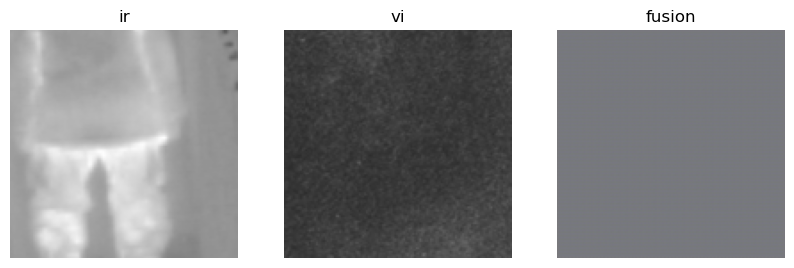

D_epoch_loss:0.4995430260896683,G_epoch_loss2.315310299396515
Epoch: 1 D_epoch_loss:0.46717291325330734,G_epoch_loss2.3602386713027954
Epoch: 2 D_epoch_loss:0.46593140810728073,G_epoch_loss2.138764500617981
Epoch: 3 D_epoch_loss:0.46569710969924927,G_epoch_loss1.661911964416504
Epoch: 4 D_epoch_loss:0.45619601011276245,G_epoch_loss1.6755907833576202
Epoch: 5 D_epoch_loss:0.42117296159267426,G_epoch_loss1.4909254014492035
Epoch: 6 D_epoch_loss:0.39773279428482056,G_epoch_loss1.3437469899654388
Epoch: 7 D_epoch_loss:0.39514049887657166,G_epoch_loss1.288617342710495
Epoch: 8 D_epoch_loss:0.3798380419611931,G_epoch_loss1.1687604188919067
Epoch: 9 D_epoch_loss:0.41692323982715607,G_epoch_loss1.262289434671402
Epoch: 10 D_epoch_loss:0.3936717212200165,G_epoch_loss1.200497031211853
Epoch: 11 D_epoch_loss:0.364104300737381,G_epoch_loss1.1195831596851349
Epoch: 12 D_epoch_loss:0.3859175443649292,G_epoch_loss1.1956043243408203
Epoch: 13 D_epoch_loss:0.3504049777984619,G_epoch_loss1.1028780043125

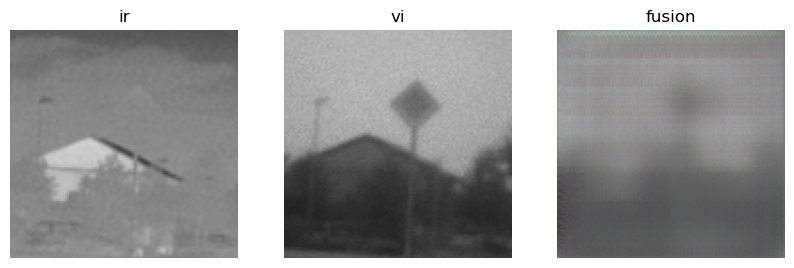

D_epoch_loss:0.4046609178185463,G_epoch_loss1.0330766141414642
Epoch: 48 D_epoch_loss:0.4308812916278839,G_epoch_loss1.0426952242851257
Epoch: 49 D_epoch_loss:0.40776533633470535,G_epoch_loss1.0203287899494171
Epoch: 50 D_epoch_loss:0.4147249907255173,G_epoch_loss1.0364745557308197
Epoch: 51 D_epoch_loss:0.4338560253381729,G_epoch_loss1.0322346687316895
Epoch: 52 D_epoch_loss:0.42505549639463425,G_epoch_loss1.0817984342575073
Epoch: 53 D_epoch_loss:0.42192935943603516,G_epoch_loss1.0554088354110718
Epoch: 54 D_epoch_loss:0.43294472247362137,G_epoch_loss1.0166424661874771
Epoch: 55 D_epoch_loss:0.4067116230726242,G_epoch_loss1.0007477104663849
Epoch: 56 D_epoch_loss:0.4407927021384239,G_epoch_loss1.0126386284828186
Epoch: 57 D_epoch_loss:0.4277479127049446,G_epoch_loss1.0293973088264465
Epoch: 58 D_epoch_loss:0.45699143409729004,G_epoch_loss1.0489728152751923
Epoch: 59 D_epoch_loss:0.4282636195421219,G_epoch_loss1.0094368606805801
Epoch: 60 D_epoch_loss:0.42967455834150314,G_epoch_loss1

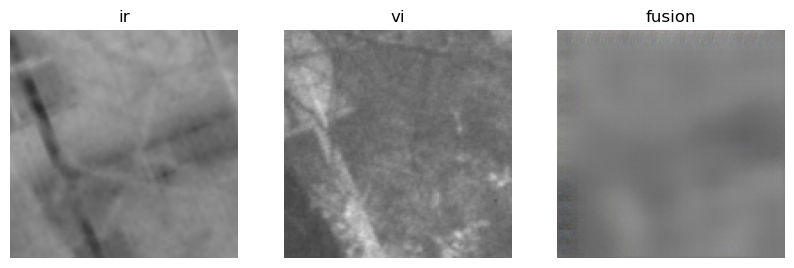

D_epoch_loss:0.38992084562778473,G_epoch_loss1.0510690808296204
Epoch: 95 D_epoch_loss:0.3964032977819443,G_epoch_loss1.0550197958946228
Epoch: 96 D_epoch_loss:0.3649180307984352,G_epoch_loss1.1005709171295166
Epoch: 97 D_epoch_loss:0.39329972863197327,G_epoch_loss1.0785987973213196
Epoch: 98 D_epoch_loss:0.3516337499022484,G_epoch_loss1.061625897884369
Epoch: 99 D_epoch_loss:0.3977421298623085,G_epoch_loss1.0912816524505615
Epoch: 100 D_epoch_loss:0.3843739181756973,G_epoch_loss1.139963060617447
Epoch: 101 D_epoch_loss:0.37262554466724396,G_epoch_loss1.049213320016861
Epoch: 102 D_epoch_loss:0.3743470832705498,G_epoch_loss1.064292997121811
Epoch: 103 D_epoch_loss:0.40327465534210205,G_epoch_loss1.0736969709396362
Epoch: 104 D_epoch_loss:0.4034781977534294,G_epoch_loss1.116445392370224
Epoch: 105 D_epoch_loss:0.38924869149923325,G_epoch_loss1.0522596538066864
Epoch: 106 D_epoch_loss:0.4236467778682709,G_epoch_loss1.0557574927806854
Epoch: 107 D_epoch_loss:0.38534606248140335,G_epoch_lo

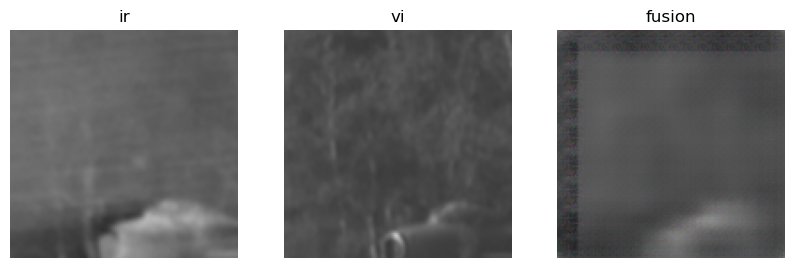

D_epoch_loss:0.4164300784468651,G_epoch_loss1.1171490252017975
Epoch: 142 D_epoch_loss:0.4120185971260071,G_epoch_loss1.1679849922657013
Epoch: 143 D_epoch_loss:0.40902377665042877,G_epoch_loss1.0842937231063843
Epoch: 144 D_epoch_loss:0.41314489394426346,G_epoch_loss1.1372570395469666
Epoch: 145 D_epoch_loss:0.3899468928575516,G_epoch_loss1.1173046231269836
Epoch: 146 D_epoch_loss:0.3861163482069969,G_epoch_loss1.122707575559616
Epoch: 147 D_epoch_loss:0.4125754162669182,G_epoch_loss1.1065969169139862
Epoch: 148 D_epoch_loss:0.39736679196357727,G_epoch_loss1.1550507247447968
Epoch: 149 D_epoch_loss:0.43560973554849625,G_epoch_loss1.131007045507431
Epoch: 150 D_epoch_loss:0.4083796441555023,G_epoch_loss1.1300659775733948
Epoch: 151 D_epoch_loss:0.39734626561403275,G_epoch_loss1.1287553310394287
Epoch: 152 D_epoch_loss:0.42921341955661774,G_epoch_loss1.1173384189605713
Epoch: 153 D_epoch_loss:0.41096416860818863,G_epoch_loss1.0896357297897339
Epoch: 154 D_epoch_loss:0.4385187029838562,G


KeyboardInterrupt



In [54]:
D_loss = []
G_loss = []
res = []
for epoch in range(5000):
    D_epoch_loss = 0
    G_epoch_loss = 0
    count = len(train_dl)
    for step,(vi,ir) in enumerate(train_dl):
        ir = ir.to(device)
        vi = vi.to(device)
        d_optimizer.zero_grad()
        #输入真实图片，判别器判定为真
        disc_real_output = dis(ir,vi) #输入真实的成对图片
        d_real_loss = loss_fn(disc_real_output,torch.ones_like(disc_real_output,device = device))
        d_real_loss.backward()
        #生成图片
        gen_output = gen(vi,ir)
        vi_disc_gen_output = dis(ir,gen_output.detach())#输入生成图像，判断可见光
        vi_d_fake_loss = loss_fn(vi_disc_gen_output,torch.zeros_like(vi_disc_gen_output,device = device))
        vi_d_fake_loss.backward()
        # 判定器的loss由两部分组成
        disc_loss = d_real_loss +(vi_d_fake_loss)
        #更新判别器参数
        d_optimizer.step()
        g_optimizer.zero_grad()
        # 将生成的图片放入判别器
        vi_disc_gen_out = dis(ir,gen_output)
        # 得到生成器的损失
        vi_gen_loss_crossentropyloss = loss_fn(vi_disc_gen_out,torch.ones_like(vi_disc_gen_out,device = device))
        vi_gen_l1_loss = torch.mean(torch.abs(gen_output - vi*0.5 - ir*0.5))
        gen_loss = vi_gen_loss_crossentropyloss+ LAMDA*(vi_gen_l1_loss)
        gen_loss.backward()
        #更新生成器梯度
        g_optimizer.step()
        with torch.no_grad():
            D_epoch_loss += disc_loss.item()
            G_epoch_loss += gen_loss.item()
    with torch.no_grad():
        D_epoch_loss /=count
        G_epoch_loss /=count
        D_loss.append(D_epoch_loss)
        G_loss.append(G_epoch_loss)
        # 训练完一个epoch就打印输出
        print("Epoch:",epoch,end=' ')
        if epoch%47==0:
            ress = genarate_images(gen,ir,vi)
            res.append(ress)
        print(f'D_epoch_loss:{D_epoch_loss},G_epoch_loss{G_epoch_loss}')

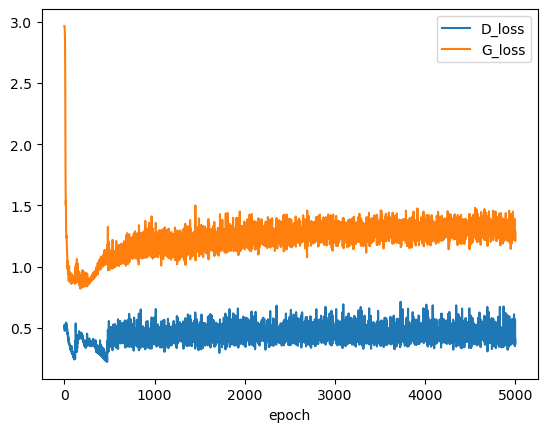

In [27]:
plt.plot(range(1, len(D_loss)+1), D_loss, label='D_loss')
plt.plot(range(1, len(G_loss)+1), G_loss, label='G_loss')
plt.xlabel('epoch')
plt.legend()
plt.show()

In [28]:
len(D_loss)

5000

In [29]:
import pandas as pd

In [30]:
data = pd.DataFrame()
data['res'] = res
data['Gloss'] = G_loss[len(res)]
data['Dloss'] = D_loss[len(res)]

In [31]:
data.to_excel('excel/01.xlsx')

In [32]:
# 模型参数保存
torch.save(gen.state_dict(), 'w/model_01.pth')

torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])


/tmp/ipykernel_10356/1961516762.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,10))


torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])
torch.Size([3, 512, 512])


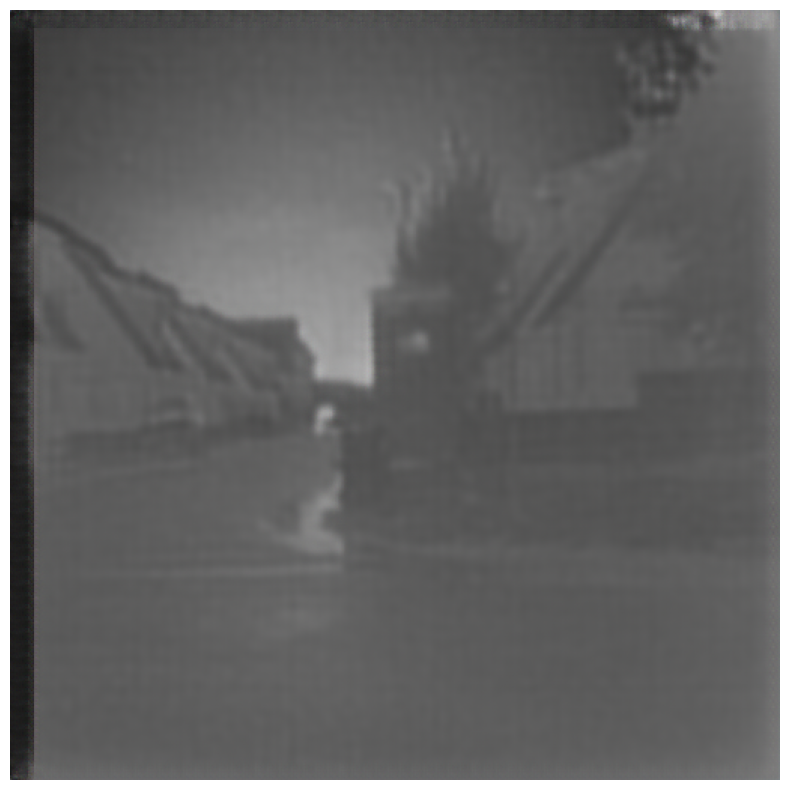

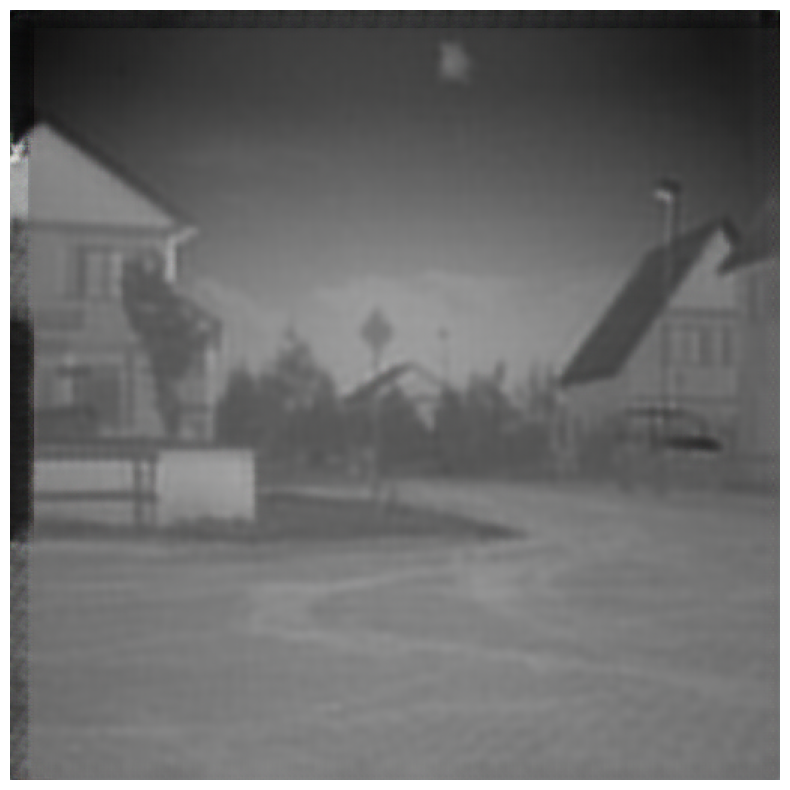

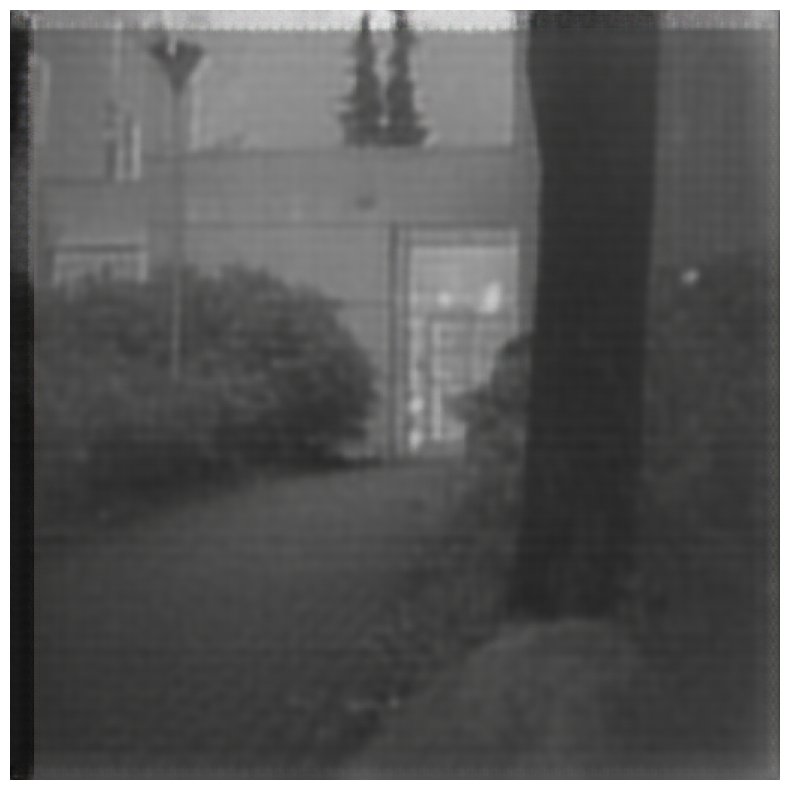

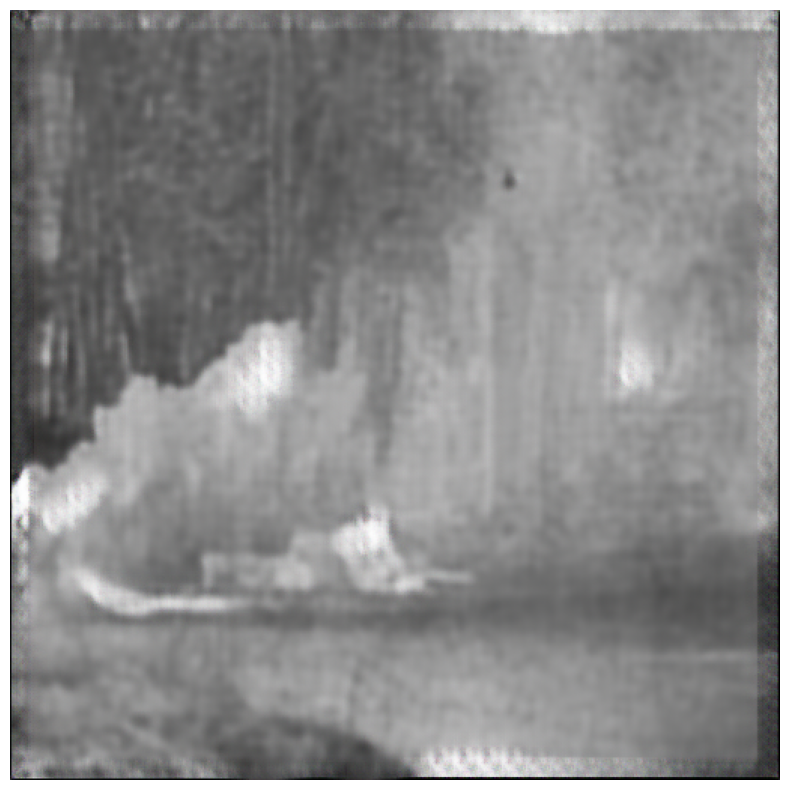

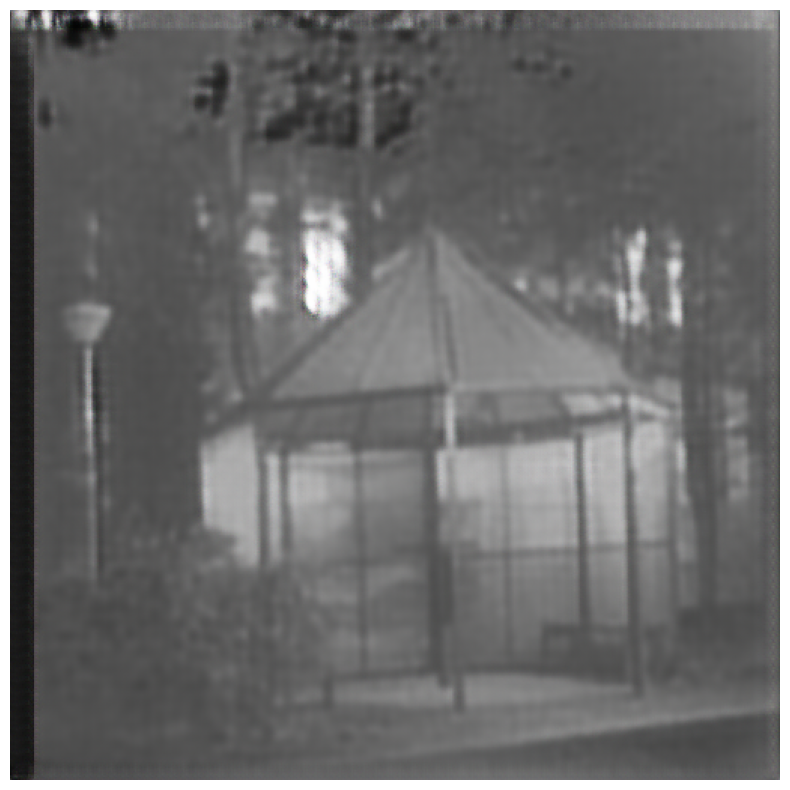

...

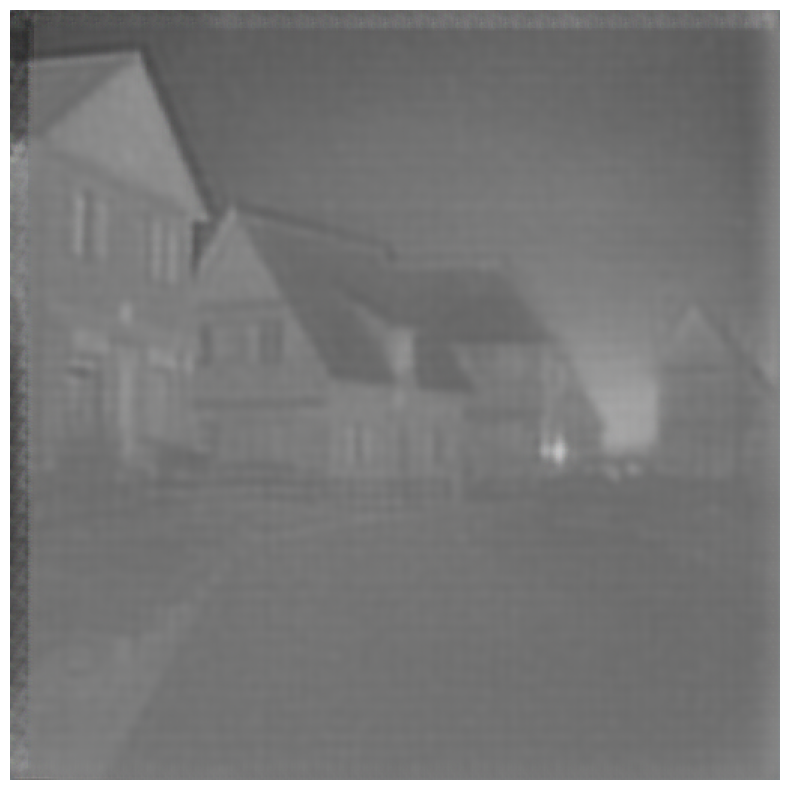

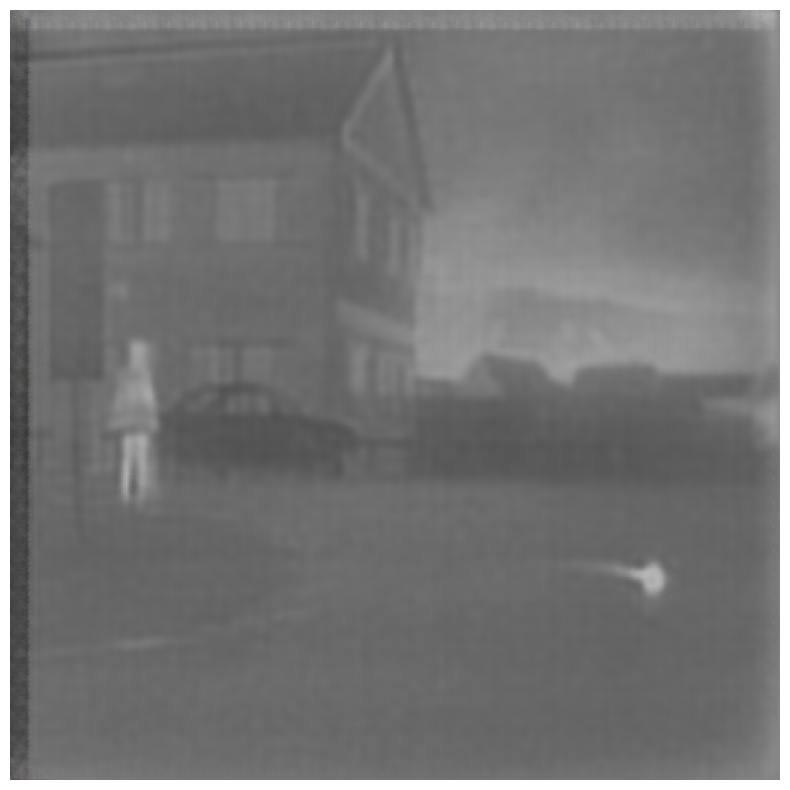

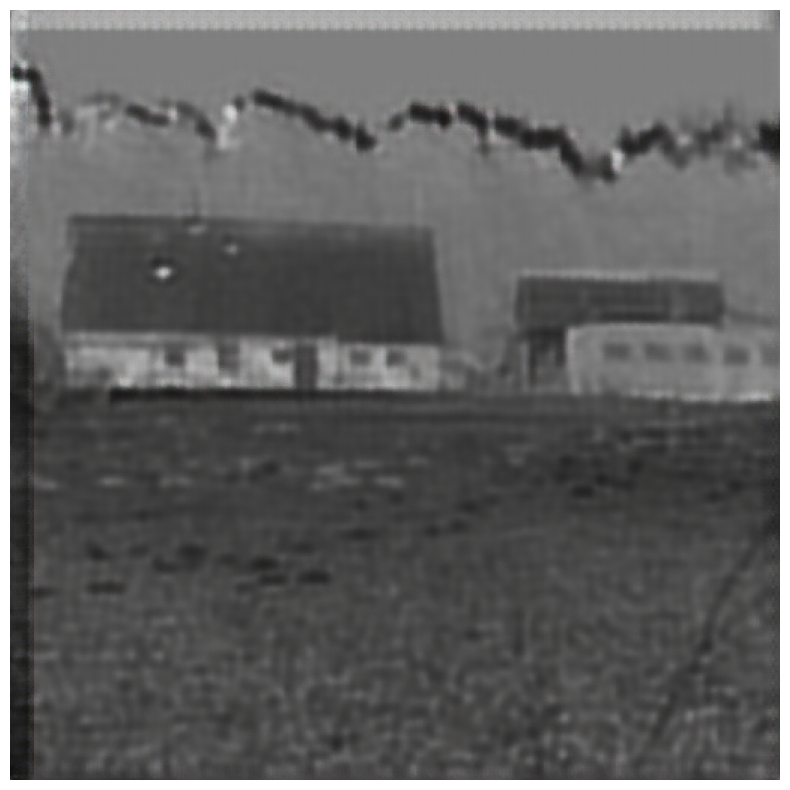

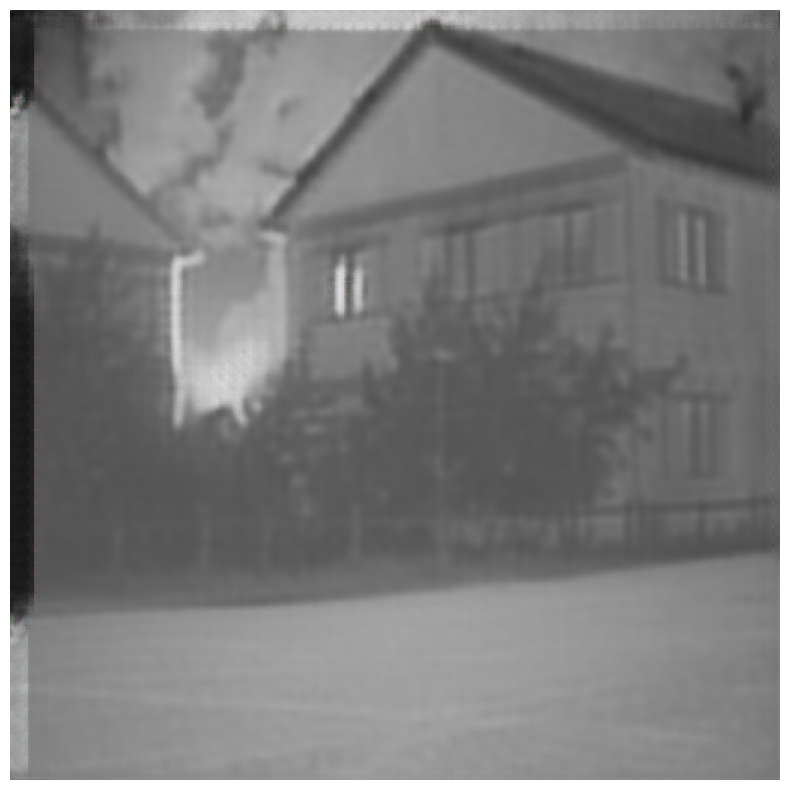

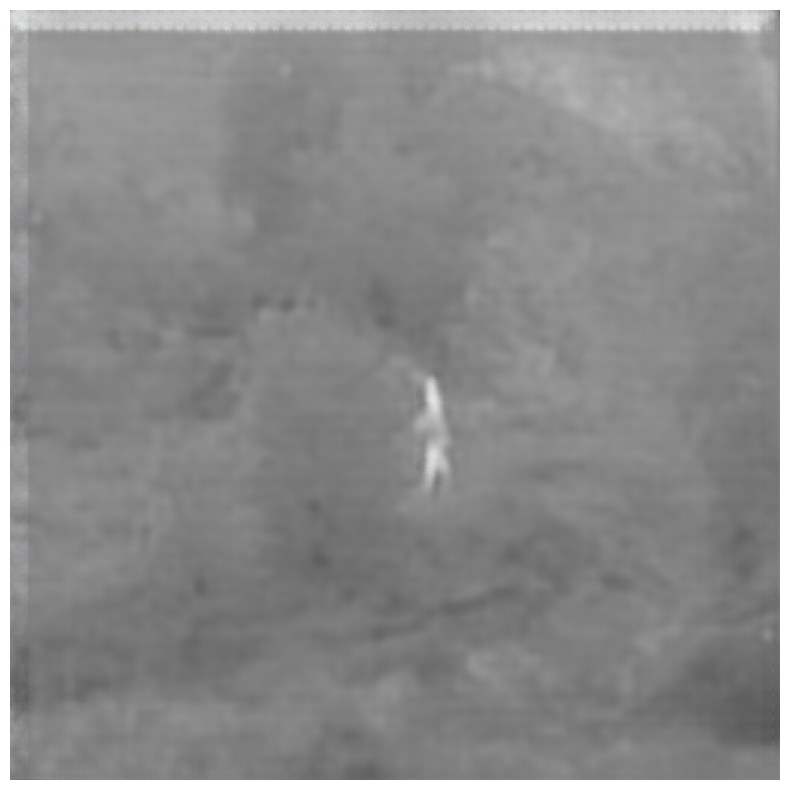

In [53]:
# gen = torch.load('w/model_01.pth')
gen.load_state_dict(torch.load('w/model_01.pth'))
for step,(vi,ir) in enumerate(train_dl):
    ir = ir.to(device)
    vi = vi.to(device)
    gen_output = gen(vi,ir)
    print(gen_output.shape)
for item,img in enumerate(gen_output):
    print(img.shape)
    img = img.permute(1,2,0).cpu().detach().numpy()
    plt.figure(figsize=(10,10))
    title = 'fusion'
    plt.imshow(img*0.5+0.5)
    plt.axis('off')  # 关闭坐标轴
    filename = 'result/01/'+str(item)+'.jpg'
    plt.savefig(filename, bbox_inches='tight', pad_inches=0)